In [ ]:
#!rm -r /content/Body_Attraction_Simulator

In [1]:
%cd /content/
!git clone https://github.com/cockles98/Body_Attraction_Simulator.git

/content
Cloning into 'Body_Attraction_Simulator'...
remote: Enumerating objects: 116, done.
remote: Counting objects: 100% (116/116), done.
remote: Compressing objects: 100% (109/109), done.
remote: Total 116 (delta 40), reused 23 (delta 6), pack-reused 0
Receiving objects: 100% (116/116), 19.84 MiB | 17.76 MiB/s, done.
Resolving deltas: 100% (40/40), done.


In [2]:
%cd Body_Attraction_Simulator
import numpy as np
from simulator import *

/content/Body_Attraction_Simulator


# Aleatory example

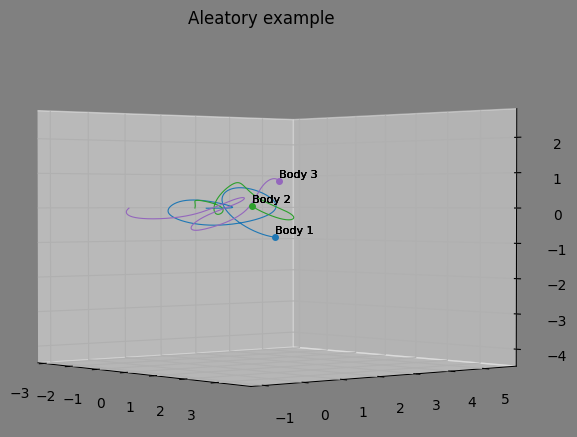

In [3]:
# Initial conditions
G = 1.0
h = 0.01
t_max = 10

masses = np.array([1.0,
                   1.0,
                   1.0])

positions = np.array([np.array([1.0, 0.0, 0.0]),
                      np.array([-0.5, 0.866, 0.0]),
                      np.array([-0.5, -0.866, 0.0])])

velocities = np.array([np.array([0.0, 1.0, 0.0]),
                       0.5*np.array([0.5, -0.25, 0.5]),
                       0.5*np.array([-0.5, -0.25, -0.5])])


# Animation
bodies_pos_list, num_frames, num_bodies = n_body_solver_3d(masses, positions, velocities, G, h, t_max)
plot_scale = [[-3.5,3.5],[-3.5,3.5],[-3.5,3.5]]
animation_3d(bodies_pos_list, num_frames, num_bodies, plot_scale, body_centered_index=0, animation_speed=4.5, title='Aleatory example')

# Solar System

Setting real masses, positions and velocities of each celestial body.

In [4]:
!pip install skyfield
from skyfield.api import load
from datetime import datetime
from pytz import timezone

# Load planetary ephemerides and define the current date and time
planet_names = ['sun', 'mercury barycenter', 'venus barycenter', 'earth barycenter', 'mars barycenter', 'jupiter barycenter', 'saturn barycenter', 'uranus barycenter', 'neptune barycenter']
planets = load('de421.bsp')
current_time = datetime.now().replace(tzinfo=timezone('UTC'))
t = load.timescale().utc(current_time)

# Stores masses, current positions and velocities
positions_3d = {}
velocities_3d = {}
for planet_name in planet_names:     # positions in meters and velocities in m/s
    positions_3d[planet_name] = planets[planet_name].at(t).position.m
    velocities_3d[planet_name] = planets[planet_name].at(t).velocity.m_per_s

masses = np.array([                  ### kg
                  1.989e30,          # Sun
                  3.3011e23,         # Mercury
                  4.8675e24,         # Venus
                  5.972e24,          # Earth
                  6.4171e23,         # Mars
                  1.8982e27,         # Jupiter
                  5.683e26,          # Saturn
                  8.681e25,          # Uranus
                  1.02413e26])       # Neptune

positions = np.array([               ### meters
                     positions_3d['sun'],
                     positions_3d['mercury barycenter'],
                     positions_3d['venus barycenter'],
                     positions_3d['earth barycenter'],
                     positions_3d['mars barycenter'],
                     positions_3d['jupiter barycenter'],
                     positions_3d['saturn barycenter'],
                     positions_3d['uranus barycenter'],
                     positions_3d['neptune barycenter']])

velocities = np.array([              ### m/s
                      velocities_3d['sun'],
                      velocities_3d['mercury barycenter'],
                      velocities_3d['venus barycenter'],
                      velocities_3d['earth barycenter'],
                      velocities_3d['mars barycenter'],
                      velocities_3d['jupiter barycenter'],
                      velocities_3d['saturn barycenter'],
                      velocities_3d['uranus barycenter'],
                      velocities_3d['neptune barycenter']])

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 446.0/446.0 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.6/47.6 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.3/232.3 kB 24.3 MB/s eta 0:00:00


[#################################] 100% de421.bsp


Animations

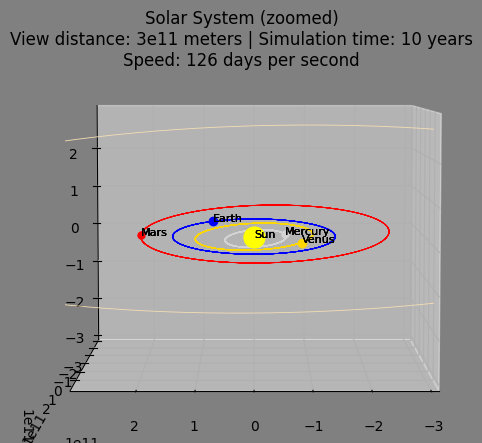

In [5]:
# Initial conditions
G = 6.67430e-11             # Gravitational constant in m^3/kg/s^2
h = 86400                   # 1 day in seconds
t_max = 10 * 365 * 86400    # 10 years in seconds

# Animation
bodies_pos_list, num_frames, num_bodies = n_body_solver_3d(masses, positions, velocities, G, h, t_max)
plot_scale = np.array([[-3e11, 3e11], [-3e11, 3e11], [-3e11, 3e11]])
animation_3d(bodies_pos_list, num_frames, num_bodies, plot_scale,
             camera_angles=[90,5],
             title='Solar System (zoomed)\nView distance: 3e11 meters | Simulation time: 10 years\nSpeed: 126 days per second',
             marker_sizes='auto',
             colors_list=['yellow', 'lightgray', 'gold', 'blue', 'red', 'wheat', 'lightyellow', 'lightseagreen', 'darkblue'],
             bodies_names=['Sun', 'Mercury', 'Venus', 'Earth', 'Mars', 'Jupiter', 'Saturn', 'Uranus', 'Neptune'],
             angular_rotation_speeds=[0.0,0.0],
             animation_speed=8,
             bodies_volume=masses,
             body_centered_index=0,
             lw = 0.6)

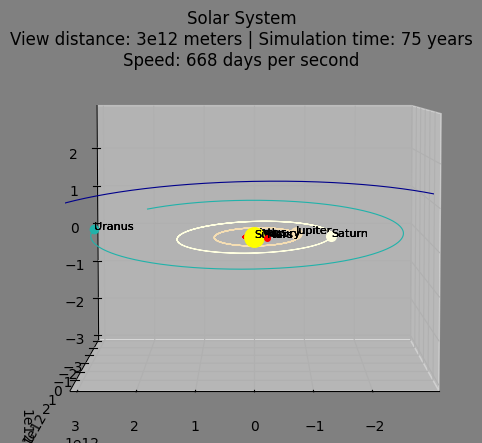

In [6]:
# Initial conditions
G = 6.67430e-11             # Gravitational constant in m^3/kg/s^2
h = 86400                   # 1 day in seconds
t_max = 75 * 365 * 86400    # 75 years in seconds

# Animation
bodies_pos_list, num_frames, num_bodies = n_body_solver_3d(masses, positions, velocities, G, h, t_max)
plot_scale = np.array([[-3e12, 3e12], [-3e12, 3e12], [-3e12, 3e12]])
animation_3d(bodies_pos_list, num_frames, num_bodies, plot_scale,
             camera_angles=[90,5],
             title='Solar System\nView distance: 3e12 meters | Simulation time: 75 years\nSpeed: 668 days per second',
             marker_sizes='auto',
             colors_list=['yellow', 'lightgray', 'gold', 'blue', 'red', 'wheat', 'lightyellow', 'lightseagreen', 'darkblue'],
             bodies_names=['Sun', 'Mercury', 'Venus', 'Earth', 'Mars', 'Jupiter', 'Saturn', 'Uranus', 'Neptune'],
             angular_rotation_speeds=[0.0,0.0],
             animation_speed=1.5,
             bodies_volume=masses,
             body_centered_index=0)

In [7]:
# Adding galaxy rotation velocity into Solar System
solar_system_vel = np.array([1.27e5, 1.27e5, 1.27e5])
velocities += solar_system_vel

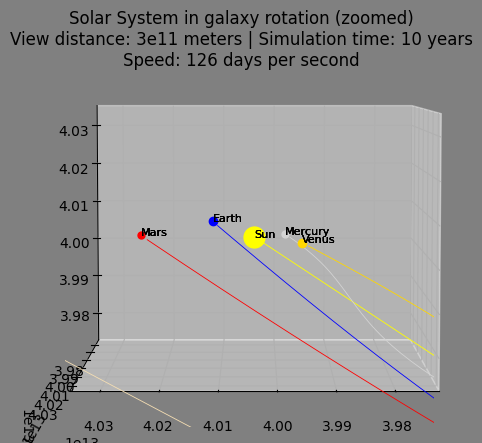

In [8]:
# Initial conditions
G = 6.67430e-11             # Gravitational constant in m^3/kg/s^2
h = 86400                   # 1 day in seconds
t_max = 10 * 365 * 86400    # 10 years in seconds

# Animation
bodies_pos_list, num_frames, num_bodies = n_body_solver_3d(masses, positions, velocities, G, h, t_max)
plot_scale = np.array([[-3e11, 3e11], [-3e11, 3e11], [-3e11, 3e11]])
animation_3d(bodies_pos_list, num_frames, num_bodies, plot_scale,
             camera_angles=[90,5],
             title='Solar System in galaxy rotation (zoomed)\nView distance: 3e11 meters | Simulation time: 10 years\nSpeed: 126 days per second',
             marker_sizes='auto',
             colors_list=['yellow', 'lightgray', 'gold', 'blue', 'red', 'wheat', 'lightyellow', 'lightseagreen', 'darkblue'],
             bodies_names=['Sun', 'Mercury', 'Venus', 'Earth', 'Mars', 'Jupiter', 'Saturn', 'Uranus', 'Neptune'],
             angular_rotation_speeds=[0.0,0.0],
             animation_speed=8,
             bodies_volume=masses,
             body_centered_index=0,
             lw = 0.6)

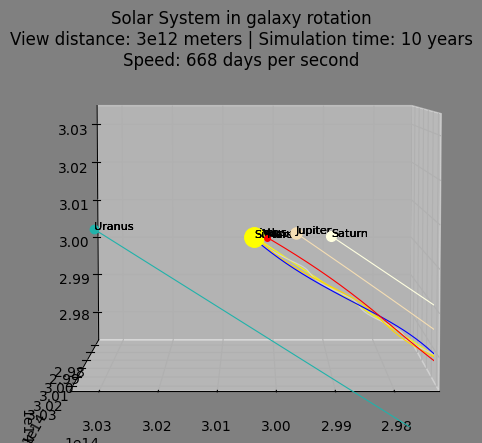

In [9]:
# Initial conditions
G = 6.67430e-11             # Gravitational constant in m^3/kg/s^2
h = 86400                   # 1 day in seconds
t_max = 75 * 365 * 86400    # 75 years in seconds
system_vel = np.array([1.27e5,1.27e5,1.27e5])

# Animation
bodies_pos_list, num_frames, num_bodies = n_body_solver_3d(masses, positions, velocities, G, h, t_max)
plot_scale = np.array([[-3e12, 3e12], [-3e12, 3e12], [-3e12, 3e12]])
animation_3d(bodies_pos_list, num_frames, num_bodies, plot_scale,
             camera_angles=[90,5],
             title='Solar System in galaxy rotation\nView distance: 3e12 meters | Simulation time: 10 years\nSpeed: 668 days per second',
             marker_sizes='auto',
             colors_list=['yellow', 'lightgray', 'gold', 'blue', 'red', 'wheat', 'lightyellow', 'lightseagreen', 'darkblue'],
             bodies_names=['Sun', 'Mercury', 'Venus', 'Earth', 'Mars', 'Jupiter', 'Saturn', 'Uranus', 'Neptune'],
             angular_rotation_speeds=[0.00,0.00],
             animation_speed=1.5,
             bodies_volume=masses,
             body_centered_index=0)